<a href="https://colab.research.google.com/github/hecescam/Brain_Tumor_Classifier/blob/main/Brain_Tumor_Classifier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



#**Brain Tumor Classifier**



El tumor cerebral se considera una de las enfermedades más agresivas, tanto en niños como en adultos. Estos representan entre el 85 y el 90% de todos los tumores primarios del Sistema Nervioso Central (SNC).

La técnica utilizada para detectarlos es la Resonancia Magnética. Los radiólogos examinan las imágenes obtenidas por la resonancia y emiten un diagnóstico.

A veces un examen manual puede ser propenso a errores debido al nivel de complejidad del tumor.

O por ejemplo en los países en vías de desarrollo, la falta de médicos cualificados y la falta de conocimiento sobre los tumores hace que la generación de informes a partir de la resonancia magnética sea un verdadero reto.

Por lo tanto la aplicación de técnicas de Deep Learning para desarrollar una herramienta de apoyo a la toma de decisiones en el diagnóstico médico puede ser muy útil para los radiólogos.

En este cuaderno se propone una clasificación de tumores cerebrales mediante redes convolucionales utilizando Transfer Learning. El objetivo es distinguir entre pacientes sanos y pacientes con patalogía. 

Autor: Héctor Escribano

##The dataset is on Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


##Unzip dataset

In [ ]:
! unzip drive/MyDrive/Datasets/Data_Brain_Tumor.zip -d ./

Archive:  drive/MyDrive/Datasets/Data_Brain_Tumor.zip
   creating: ./Data_Brain_Tumor/Testing/
   creating: ./Data_Brain_Tumor/Testing/glioma_tumor/
  inflating: ./Data_Brain_Tumor/Testing/glioma_tumor/image(1).jpg  
  inflating: ./Data_Brain_Tumor/Testing/glioma_tumor/image(10).jpg  
  inflating: ./Data_Brain_Tumor/Testing/glioma_tumor/image(100).jpg  
  inflating: ./Data_Brain_Tumor/Testing/glioma_tumor/image(11).jpg  
  inflating: ./Data_Brain_Tumor/Testing/glioma_tumor/image(12).jpg  
  inflating: ./Data_Brain_Tumor/Testing/glioma_tumor/image(13).jpg  
  inflating: ./Data_Brain_Tumor/Testing/glioma_tumor/image(14).jpg  
  inflating: ./Data_Brain_Tumor/Testing/glioma_tumor/image(17).jpg  
  inflating: ./Data_Brain_Tumor/Testing/glioma_tumor/image(18).jpg  
  inflating: ./Data_Brain_Tumor/Testing/glioma_tumor/image(2).jpg  
  inflating: ./Data_Brain_Tumor/Testing/glioma_tumor/image(20).jpg  
  inflating: ./Data_Brain_Tumor/Testing/glioma_tumor/image(21).jpg  
  inflating: ./Data_Brai

##Import libreries 

In [ ]:
import seaborn as sns
from keras import optimizers
from keras.models import load_model
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import cv2
from sklearn.metrics import classification_report
import pickle
import random as rn
from sklearn.dummy import DummyClassifier

%matplotlib inline

## Import libreries with functions and class. These libreries are next to this netebook:
 - data_preprocessing.py
 - class_model_train.py
 - evaluate_network.py

 The libraries have to be in the working environment.

In [ ]:
from data_preprocessing import *
from class_model_train import *
from evaluate_network import *


##Preparation of sets


In [ ]:
path_train='./Data_Brain_Tumor/Training/'
path_test='./Data_Brain_Tumor/Testing/'

list_target=[('glioma_tumor','YES'),('meningioma_tumor','YES'),('no_tumor','NO'),('pituitary_tumor','YES')]

dataframe_train,dataframe_val=set_split(path_train,list_target,0.15)
dataframe_test=set_split(path_test,list_target,0)

print('Examples in the train set      : ',len(dataframe_train))
print('Examples in the validation set : ',len(dataframe_val))
print('Examples in the test set       : ',len(dataframe_test))

Examples in the train set      :  2439
Examples in the validation set :  431
Examples in the test set       :  378


##Different samples of each class of the train set

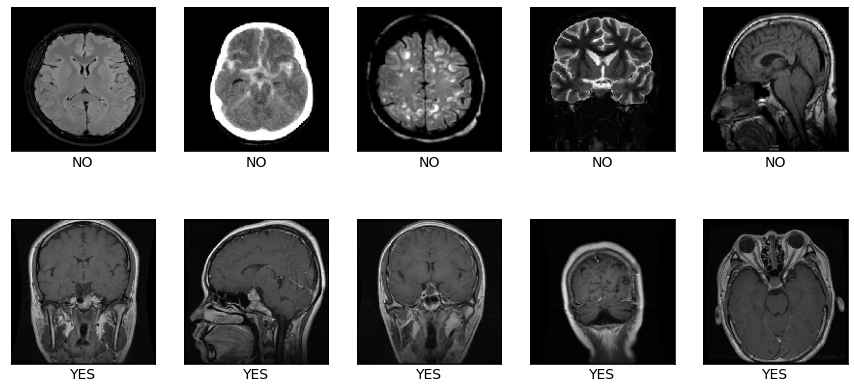

In [ ]:
show_images_class(dataframe_train)

## Distribution of classes in the train set

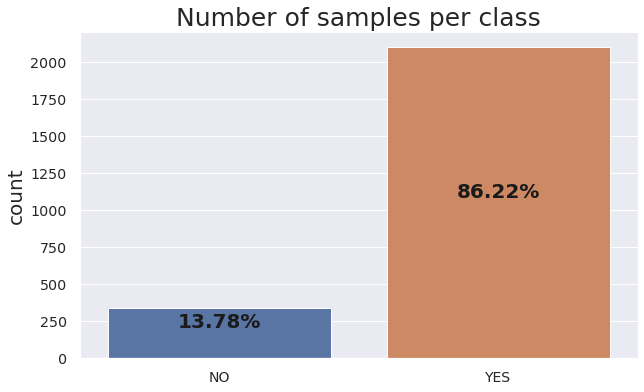

In [ ]:
countplot_classes (dataframe_train,'class')

##Distribution of classes in the validation set

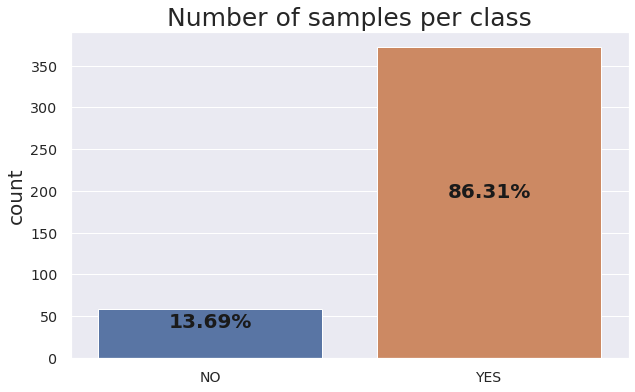

In [ ]:
countplot_classes (dataframe_val,'class')

##Distribution of classes in the test set

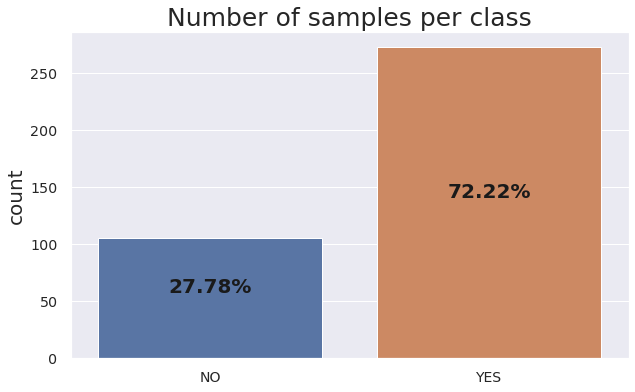

In [ ]:
countplot_classes (dataframe_test,'class')

## Global variable definition

In [ ]:
IMG_SIZE = (224, 224)
BATCH_SIZE=16

##Finding extreme points in contours with OpenCV

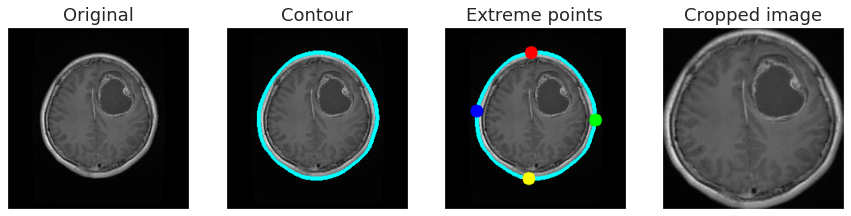

In [ ]:
image = cv2.imread(dataframe_train.iloc[1700]['filepath'])
list_crop=extreme_points_contours(image,img_size=IMG_SIZE,generator=False)
show_extreme_points_contours(list_crop)

## Preparation of batch loaders by applying the preprocessing function 

In [ ]:
preprocess_input = lambda x:extreme_points_contours(x)
#preprocess_input = lambda x:x

train_datagen=image_data_generator(preprocess_input,augmentation=True)

train_generator=generator_from_dataframe(train_datagen,dataframe_train,IMG_SIZE,BATCH_SIZE,suff=True,mode='sparse')


validation_datagen=image_data_generator(preprocess_input,augmentation=False)

validation_generator=generator_from_dataframe(validation_datagen,dataframe_val,IMG_SIZE,BATCH_SIZE,suff=False,mode='sparse')


test_datagen=image_data_generator(preprocess_input,augmentation=False)

test_generator=generator_from_dataframe(test_datagen,dataframe_test,IMG_SIZE,BATCH_SIZE,suff=False,mode='sparse')


Found 2439 validated image filenames belonging to 2 classes.
Found 431 validated image filenames belonging to 2 classes.
Found 378 validated image filenames belonging to 2 classes.


## Data Augmentation effect

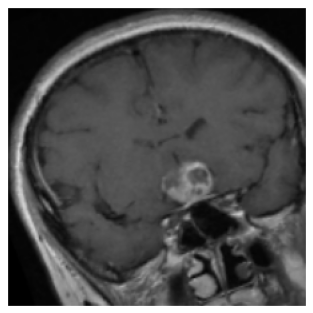

In [ ]:
train_generator.reset()
X_te, y_te = train_generator.next()
plt.imshow(X_te[2])
plt.xticks([])
plt.yticks([])
plt.show()

## Baseline Model (Dummy)

In [ ]:
train_datagen2=image_data_generator(preprocess_input,augmentation=False)

train_generator2=generator_from_dataframe(train_datagen2,dataframe_train,IMG_SIZE,train_generator.n,suff=False,mode='sparse')


test_datagen2=image_data_generator(preprocess_input,augmentation=False)

test_generator2=generator_from_dataframe(test_datagen2,dataframe_test,IMG_SIZE,test_generator.n,suff=False,mode='sparse')

train_generator2.reset()

X_train, y_train = train_generator2.next()


test_generator2.reset()

X_test, y_test = test_generator2.next()

Found 2439 validated image filenames belonging to 2 classes.
Found 378 validated image filenames belonging to 2 classes.


In [ ]:
from sklearn.dummy import DummyClassifier

clf = DummyClassifier(strategy="most_frequent")
clf.fit(X_train,y_train)
#clf.fit(train_generator, np.argmax(y_train,1))
print('Train accuracy:', clf.score(X_train,y_train))
print('Test accuracy :', clf.score(X_test, y_test))

Train accuracy: 0.8622386223862238
Test accuracy : 0.7222222222222222


## Create model VGG16 (Transfer Learning)

In [ ]:
np.random.seed(123)
rn.seed(123)
tf.random.set_seed(123)


optimizer=optimizers.Adam(lr=0.0001)
loss='sparse_categorical_crossentropy'
nclasses=2
num_trainable=4
layers=[1024,128]
model=Model_VGG16(IMG_SIZE+(3,),layers,nclasses,optimizer,loss,num_trainable)

Model: "VGG16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

##Training 

In [ ]:
EPOCHS=10

hist=model.train_model(train_generator,EPOCHS,validation_generator)

Epoch 1/10
153/153 [==============================] - 43s 276ms/step - loss: 0.5420 - accuracy: 0.8231 - val_loss: 0.3815 - val_accuracy: 0.8747

Epoch 00001: val_accuracy improved from -inf to 0.87471, saving model to best_model.h5
Epoch 2/10
153/153 [==============================] - 42s 273ms/step - loss: 0.2456 - accuracy: 0.9212 - val_loss: 0.1246 - val_accuracy: 0.9652

Epoch 00002: val_accuracy improved from 0.87471 to 0.96520, saving model to best_model.h5
Epoch 3/10
153/153 [==============================] - 41s 270ms/step - loss: 0.1320 - accuracy: 0.9566 - val_loss: 0.1571 - val_accuracy: 0.9606

Epoch 00003: val_accuracy did not improve from 0.96520
Epoch 4/10
153/153 [==============================] - 41s 268ms/step - loss: 0.1216 - accuracy: 0.9614 - val_loss: 0.1148 - val_accuracy: 0.9675

Epoch 00004: val_accuracy improved from 0.96520 to 0.96752, saving model to best_model.h5
Epoch 5/10
153/153 [==============================] - 40s 264ms/step - loss: 0.1115 - accuracy

## Saving the model's history

In [ ]:
with open('./history_brain_tumor.pkl', 'wb') as file_pi:
  pickle.dump(hist.history, file_pi)

## Loading the model's history

In [ ]:
with open('./history_brain_tumor.pkl', "rb") as f:
    history_tumor = pickle.load(f)

## Plot training

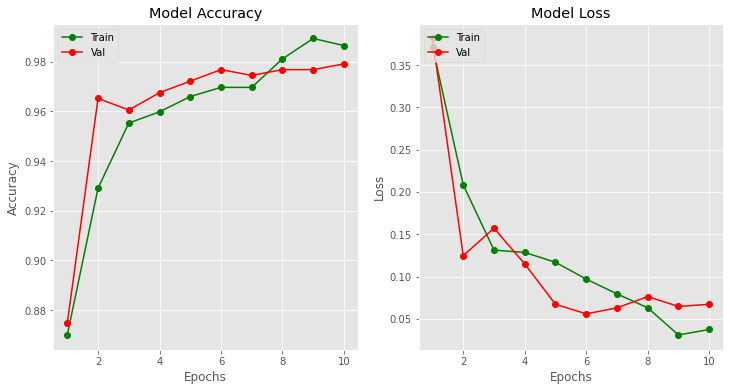

In [ ]:
plot_history(history_tumor)

##Loading best model

In [ ]:
ruta='best_model.h5'
model = load_model(ruta)

## Evaluate the model in the 3 sets 

In [ ]:
evaluate_model_accuracy(model,train_generator,'Train')
evaluate_model_accuracy(model,validation_generator,'Validation')
evaluate_model_accuracy(model,test_generator,'Test')

153/153 [==============================] - 39s 255ms/step - loss: 0.0173 - accuracy: 0.9947
Train  loss    : 0.01729637384414673
Train  accuracy: 0.9946699738502502

27/27 [==============================] - 2s 89ms/step - loss: 0.0671 - accuracy: 0.9791
Validation  loss    : 0.06712199002504349
Validation  accuracy: 0.9791183471679688

24/24 [==============================] - 2s 74ms/step - loss: 0.1669 - accuracy: 0.9550
Test  loss    : 0.16694560647010803
Test  accuracy: 0.9550264477729797



#TEST

## Predictions

In [ ]:
prob=predict_model(model,test_generator)
preds_max = np.argmax(prob, axis = 1)

print(classification_report(test_generator.classes, preds_max))

              precision    recall  f1-score   support

           0       0.90      0.94      0.92       105
           1       0.98      0.96      0.97       273

    accuracy                           0.96       378
   macro avg       0.94      0.95      0.94       378
weighted avg       0.96      0.96      0.96       378



In [ ]:
prob=predict_model(model,test_generator)
preds_max = np.argmax(prob, axis = 1)

print(classification_report(test_generator.classes, preds_max))

              precision    recall  f1-score   support

           0       0.90      0.94      0.92       105
           1       0.98      0.96      0.97       273

    accuracy                           0.96       378
   macro avg       0.94      0.95      0.94       378
weighted avg       0.96      0.96      0.96       378



## Curve ROC and Curve Precision-Recall

AUC:  0.9882435025292168
Best Threshold=0.450971, J=0.906


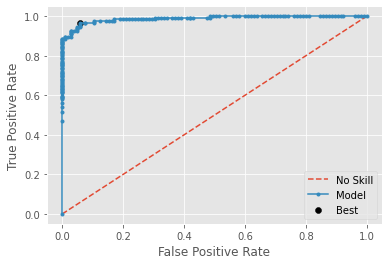

AUC:  0.995778061827522
Best Threshold=0.450971, Precision=0.978, Recall=0.963, F-Score=0.970


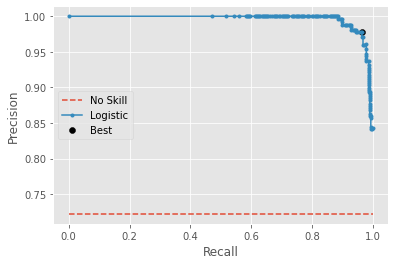

In [ ]:
curve_ROC(test_generator.classes,test_generator.class_indices,prob)

## Confusion Matrix

### - Threshold = 0.50

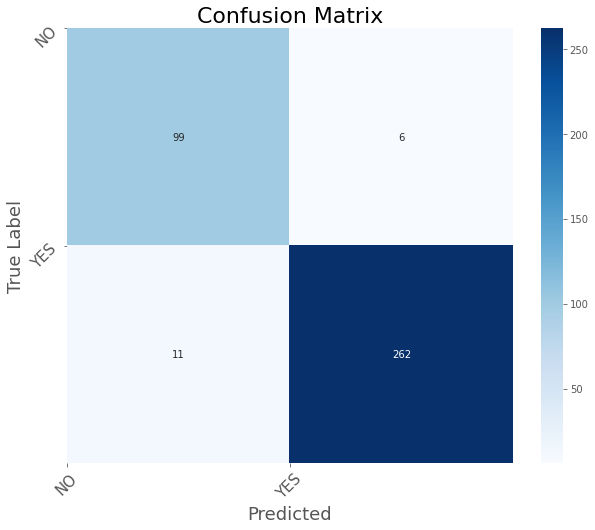

In [ ]:
confusion_matrix_model(test_generator.classes,test_generator.class_indices,prob,0.5)

### - Threshold = 0.45

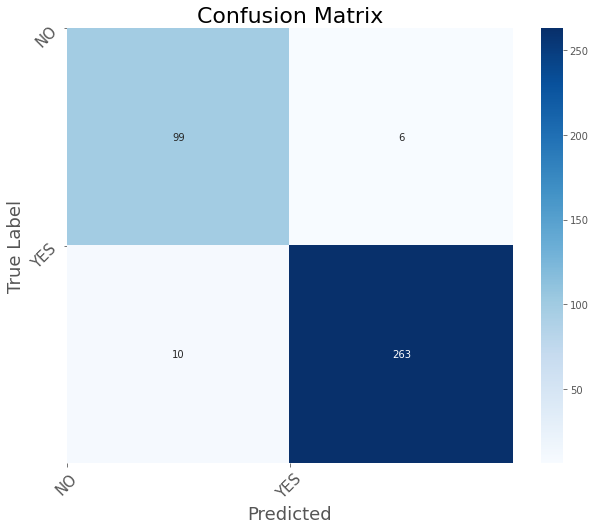

In [ ]:
confusion_matrix_model(test_generator.classes,test_generator.class_indices,prob,0.45)

### - Threshold = 0.35

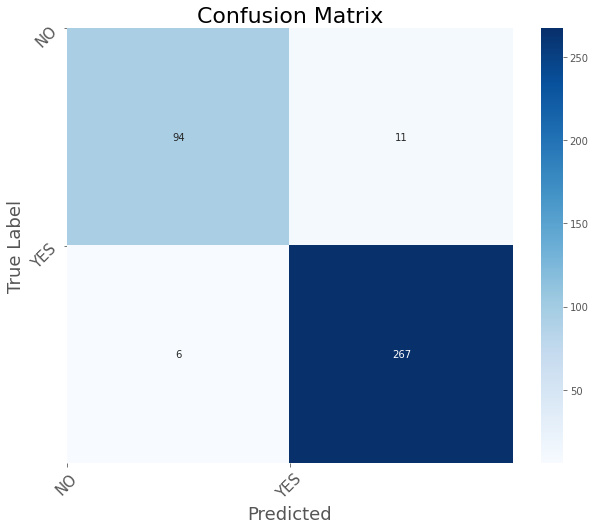

In [ ]:
confusion_matrix_model(test_generator.classes,test_generator.class_indices,prob,0.35)

#Visualise network operation

## New test loader with full batch size

In [ ]:
test_datagen2=image_data_generator(preprocess_input,augmentation=False)

test_generator2=generator_from_dataframe(test_datagen,dataframe_test,IMG_SIZE,test_generator.n,suff=False,mode='sparse')

test_generator2.reset()

X_te, y_te = test_generator2.next()


Found 378 validated image filenames belonging to 2 classes.


## Dictionary:
 - key: name class
 - value: number

In [ ]:
class_indices = test_generator2.class_indices
class_indices

{'NO': 0, 'YES': 1}

## Dictionary:
 - key: number
 - value: name class

In [ ]:
num_class = {test_generator2.class_indices[x]:x  for x in test_generator2.class_indices.keys()}
num_class

{0: 'NO', 1: 'YES'}

## Visualise the classification of an example

.Real Class: NO
 - Probability of NO : 99.9%
 - Probability of YES : 0.1%


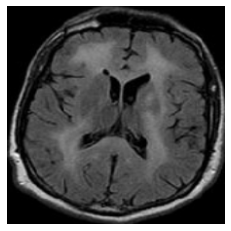

In [ ]:
show_classified_image(model,X_te[2],class_indices,num_class[y_te[2]])

## Network weights per layer

In [ ]:
show_shape_weights(model.get_weights())

SHAPE WEIGHTS:  (32,) 

shape of weights[0]:  (3, 3, 3, 64)
shape of weights[1]:  (64,)
shape of weights[2]:  (3, 3, 64, 64)
shape of weights[3]:  (64,)
shape of weights[4]:  (3, 3, 64, 128)
shape of weights[5]:  (128,)
shape of weights[6]:  (3, 3, 128, 128)
shape of weights[7]:  (128,)
shape of weights[8]:  (3, 3, 128, 256)
shape of weights[9]:  (256,)
shape of weights[10]:  (3, 3, 256, 256)
shape of weights[11]:  (256,)
shape of weights[12]:  (3, 3, 256, 256)
shape of weights[13]:  (256,)
shape of weights[14]:  (3, 3, 256, 512)
shape of weights[15]:  (512,)
shape of weights[16]:  (3, 3, 512, 512)
shape of weights[17]:  (512,)
shape of weights[18]:  (3, 3, 512, 512)
shape of weights[19]:  (512,)
shape of weights[20]:  (3, 3, 512, 512)
shape of weights[21]:  (512,)
shape of weights[22]:  (3, 3, 512, 512)
shape of weights[23]:  (512,)
shape of weights[24]:  (3, 3, 512, 512)
shape of weights[25]:  (512,)
shape of weights[26]:  (25088, 1024)
shape of weights[27]:  (1024,)
shape of weights

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


## Visualise weights in a layer

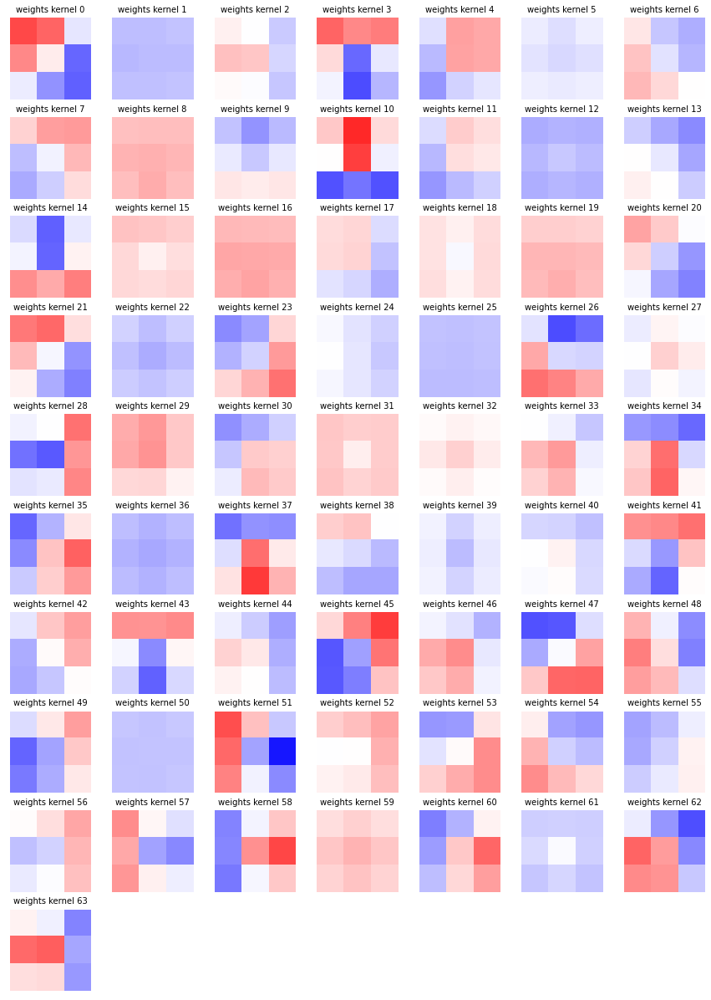

In [ ]:
show_weights_layer(model.get_weights(),0)

## Build the intermediate model. The output layer is the first convolutional layer of the original model.

In [ ]:
nlayer=1

inter_model=build_model_intermediate(model,nlayer,input_layer=True)
inter_model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
Total params: 1,792
Trainable params: 0
Non-trainable params: 1,792
_________________________________________________________________


## Visualise outputs in the first layer

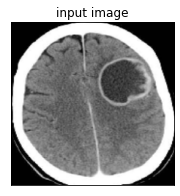


Outputs layer block1_conv1 (1, 224, 224, 64) 



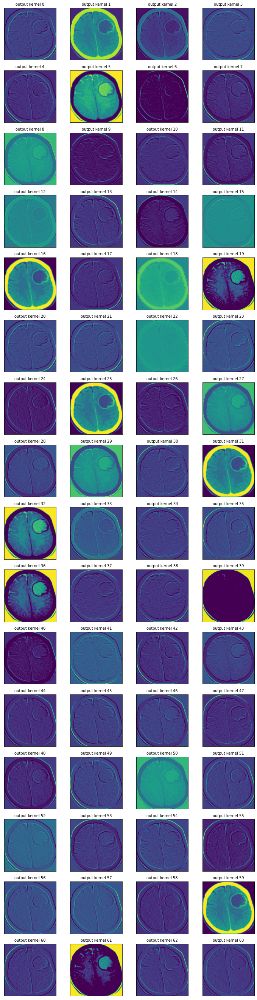

In [ ]:
ind = 200

image = X_te[ind]
aux = np.expand_dims(image, axis=0)
activations = inter_model.predict(aux)

show_output_first_convlayer(inter_model,image,activations)

##Build the intermediate model. The output layer is the last convolutional layer of the original model.

In [ ]:
nlayer=17

inter_model=build_model_intermediate(model,nlayer,input_layer=True)
inter_model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0   

## Visualise outputs in multiple layers

/content/evaluate_network.py:210: RuntimeWarning: invalid value encountered in true_divide
  channel_image /= channel_image.std()


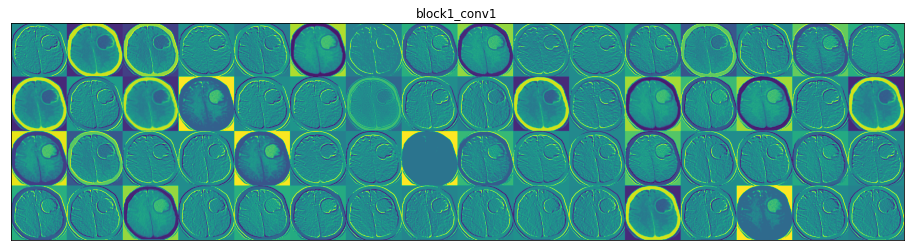

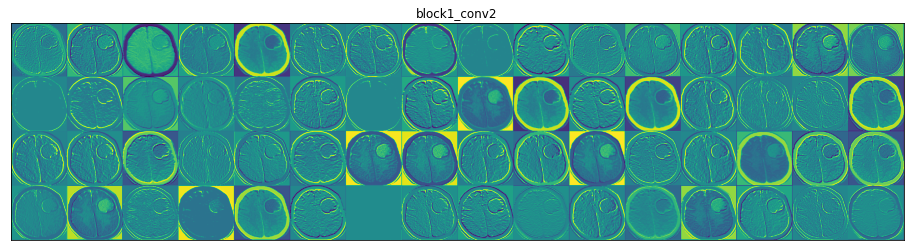

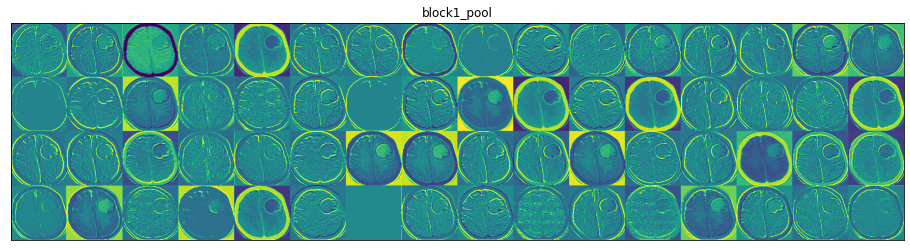

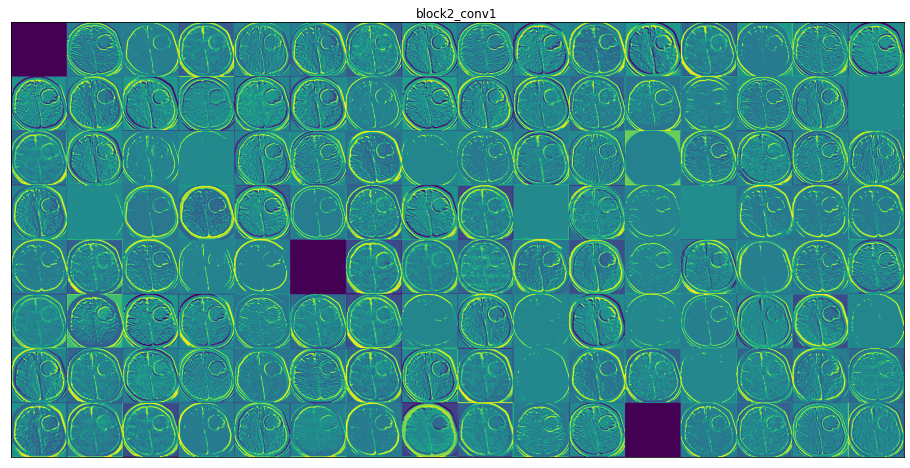

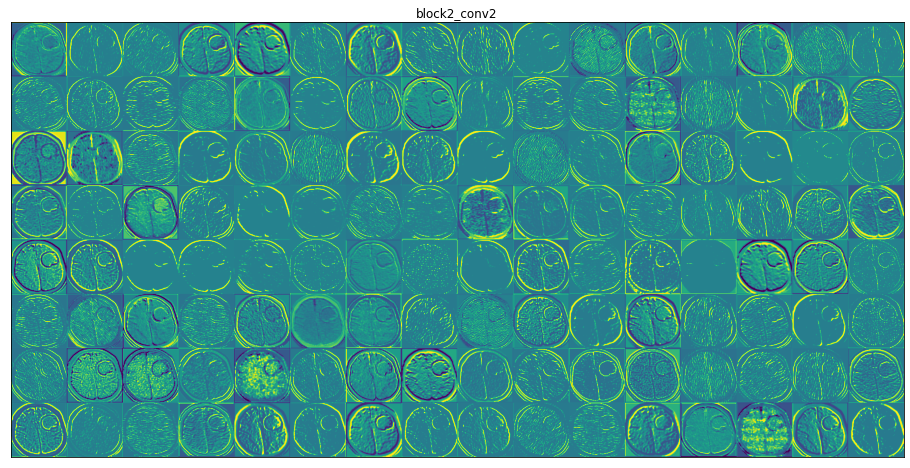

...

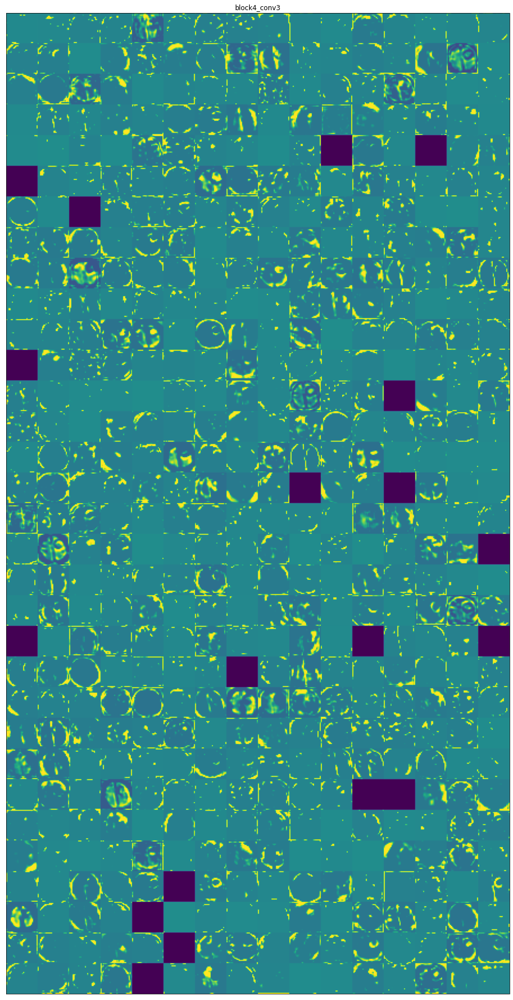

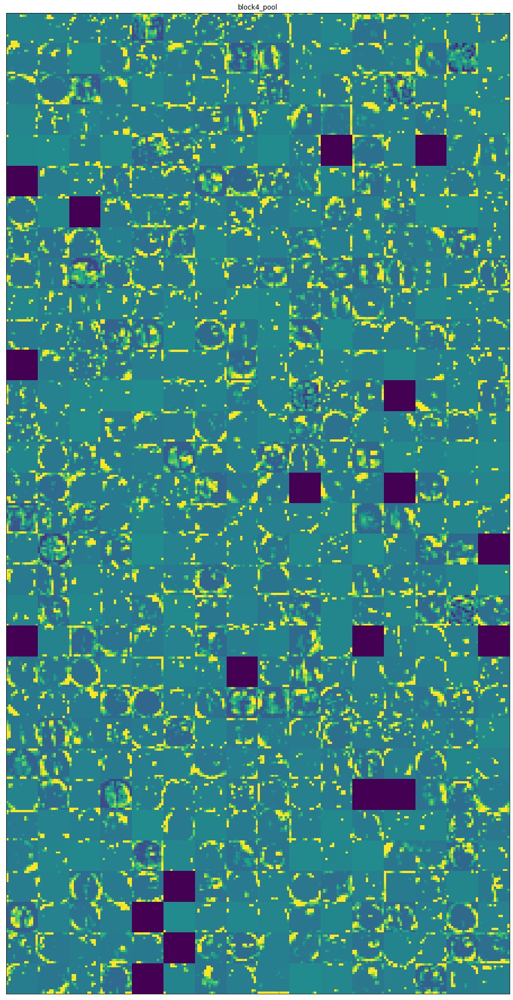

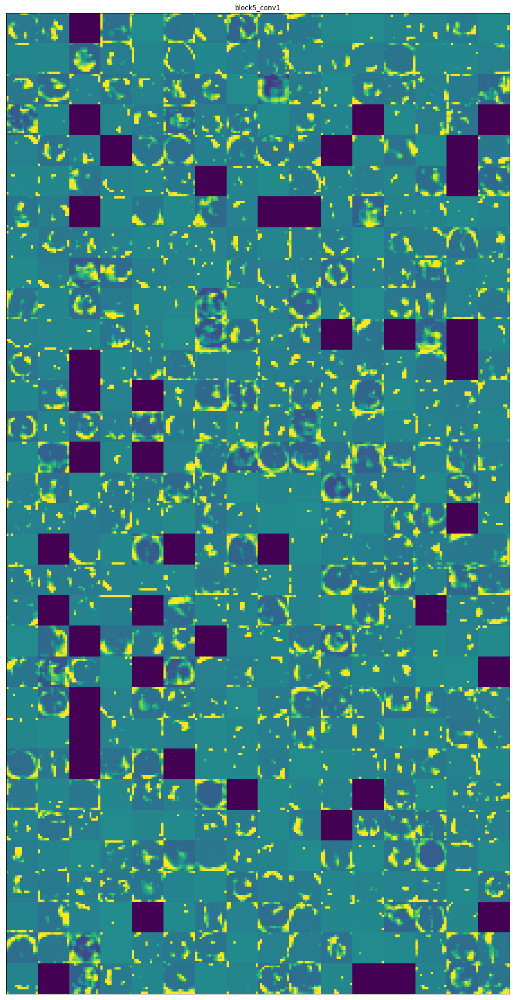

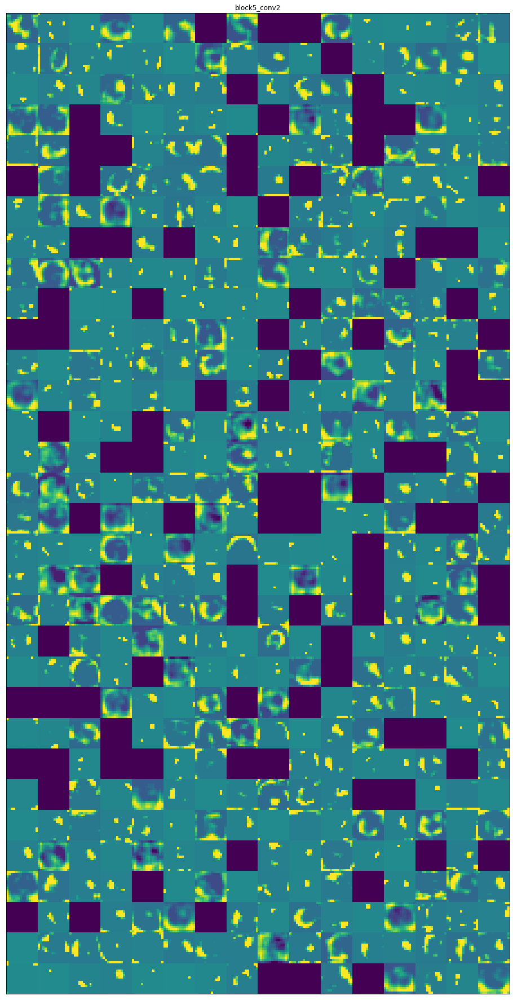

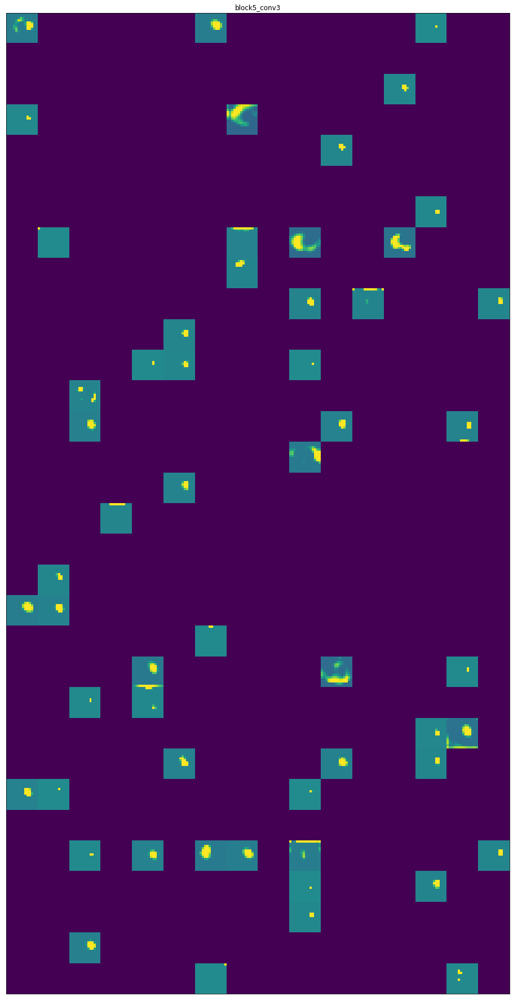

In [ ]:
ind = 200

image = X_te[ind]
aux = np.expand_dims(image, axis=0)
activations = inter_model.predict(aux)

show_outputs_layers(inter_model,activations)

## Visualise Heatmaps in a few examples

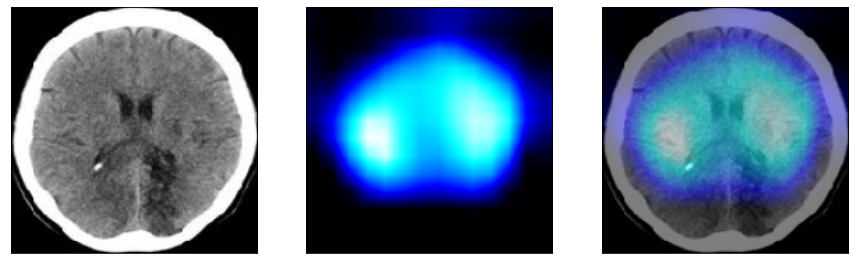

  NO: 99%   YES: 0% 





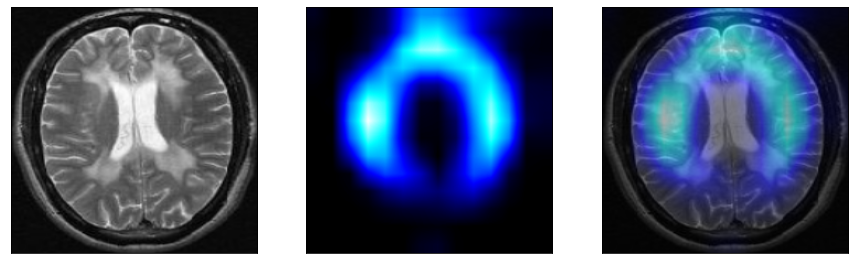

  NO: 99%   YES: 0% 





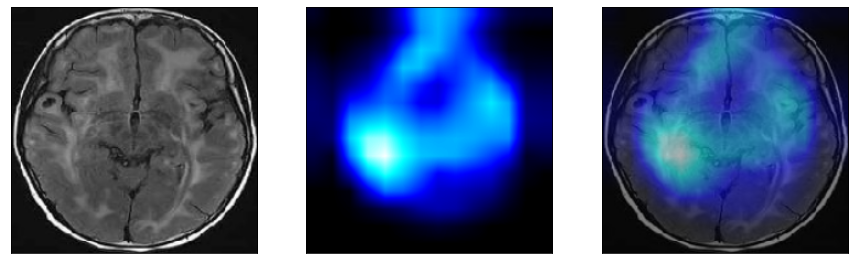

  NO: 99%   YES: 0% 





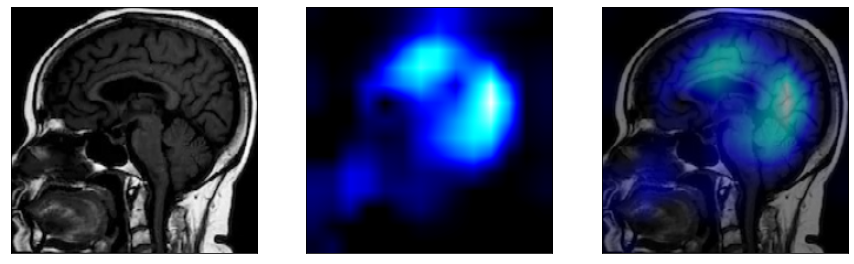

  NO: 99%   YES: 0% 





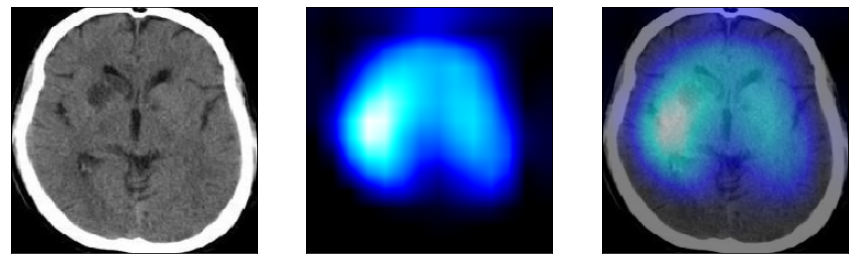

  NO: 99%   YES: 0% 





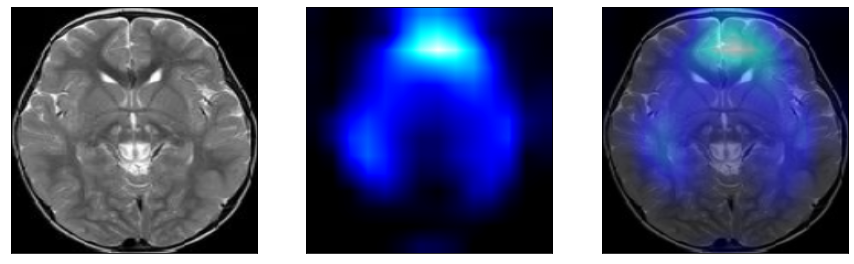

  NO: 99%   YES: 0% 





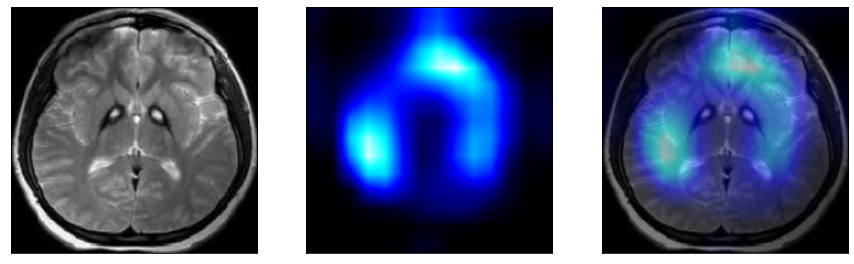

  NO: 99%   YES: 0% 





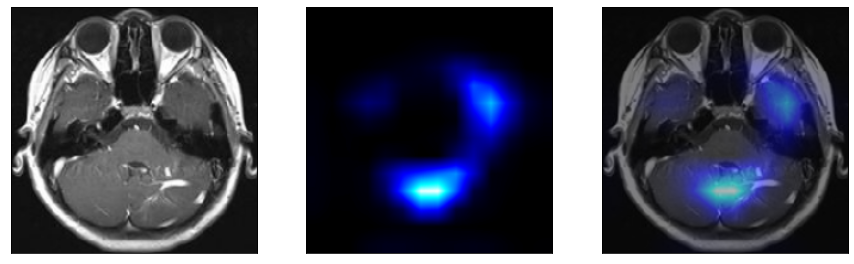

  NO: 1%   YES: 98% 





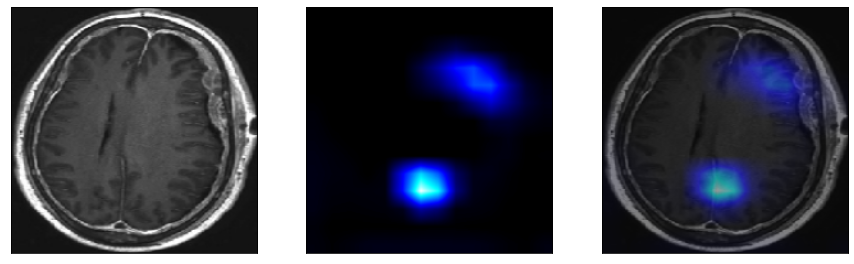

  NO: 6%   YES: 93% 





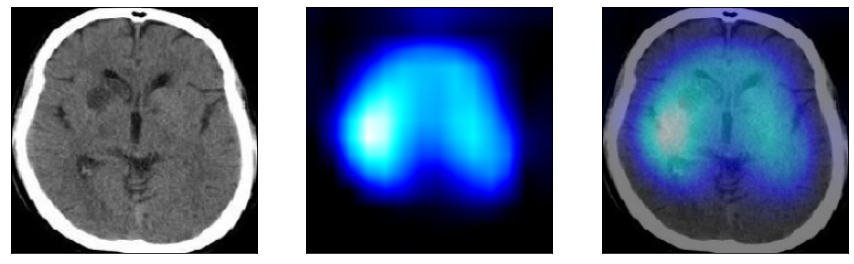

  NO: 99%   YES: 0% 





In [ ]:
ind = 60 

for i in range(ind, ind+10):
    show_heatmap(model, X_te[i], num_class)

## Visualise the worst results for the NO class

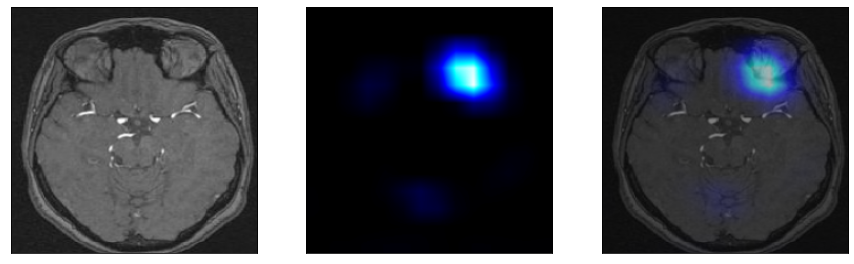

  NO: 0%   YES: 99% 





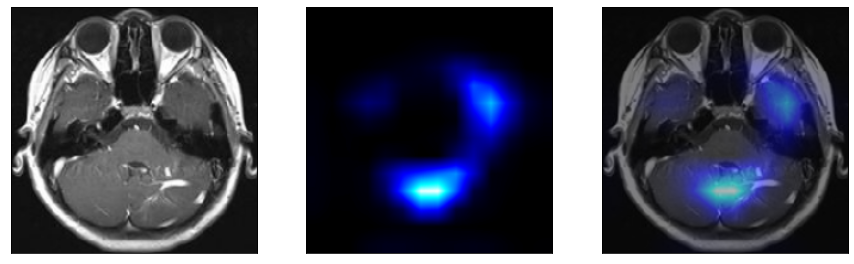

  NO: 1%   YES: 98% 





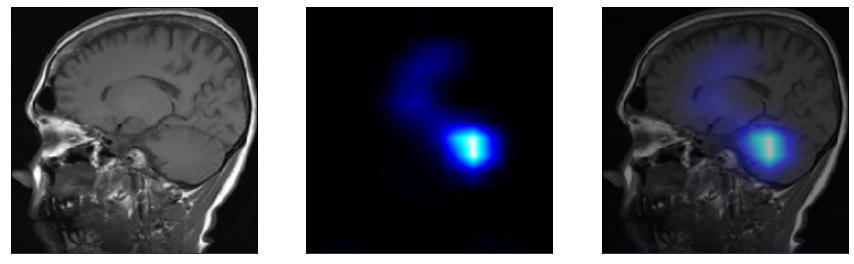

  NO: 1%   YES: 98% 





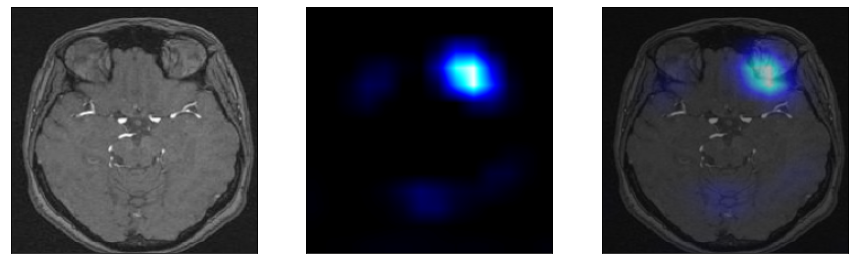

  NO: 4%   YES: 95% 





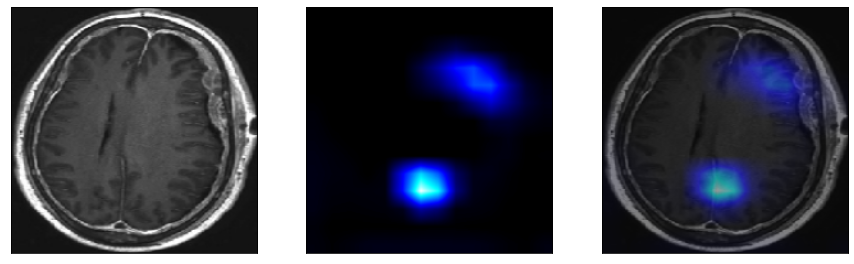

  NO: 6%   YES: 93% 





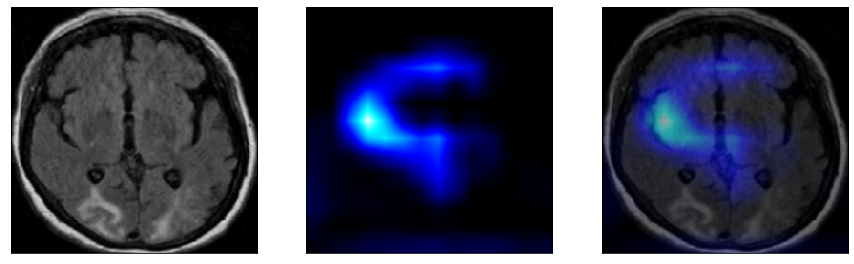

  NO: 23%   YES: 76% 





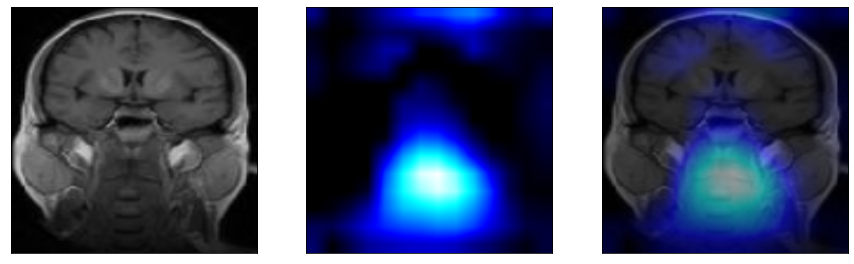

  NO: 55%   YES: 44% 





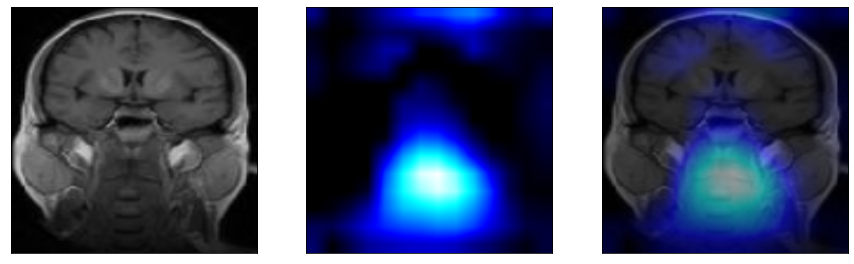

  NO: 55%   YES: 44% 





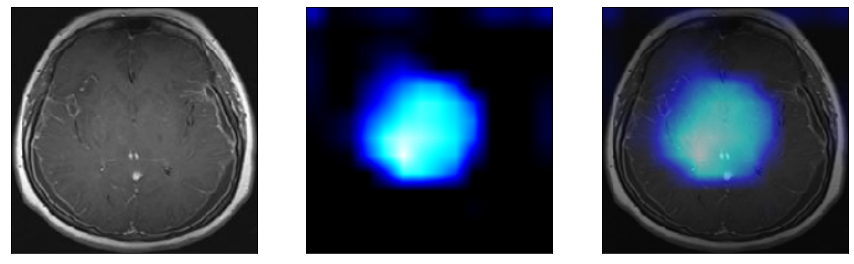

  NO: 59%   YES: 40% 





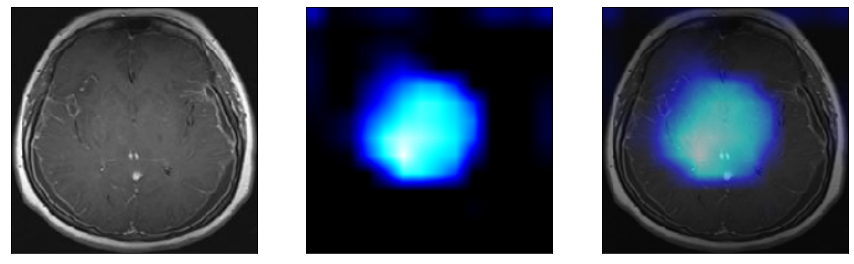

  NO: 59%   YES: 40% 





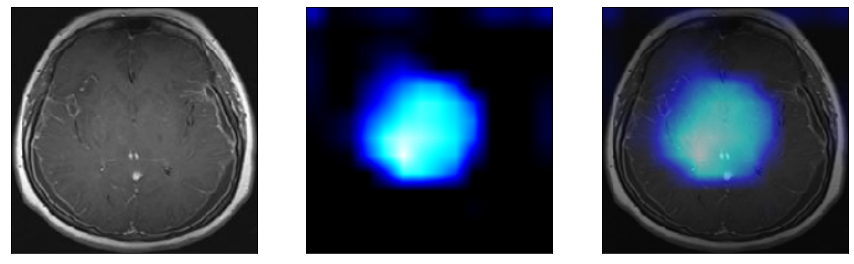

  NO: 59%   YES: 40% 





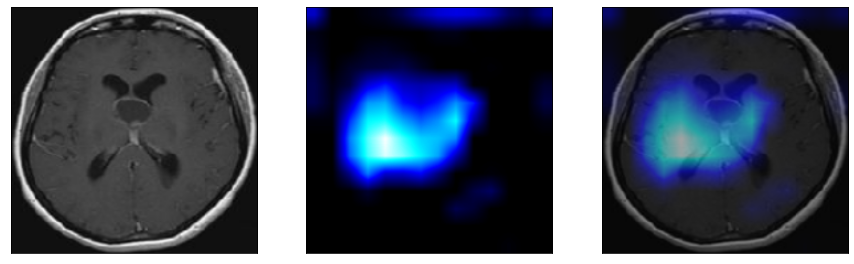

  NO: 65%   YES: 34% 





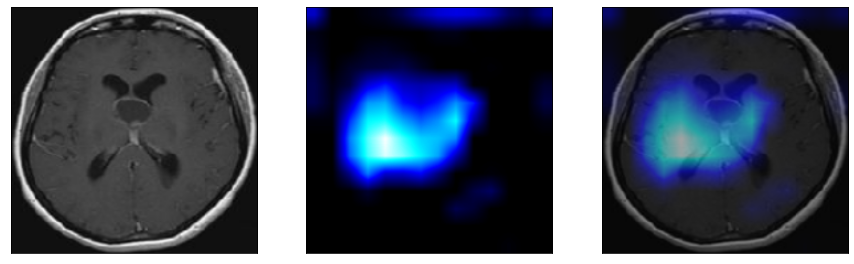

  NO: 65%   YES: 34% 





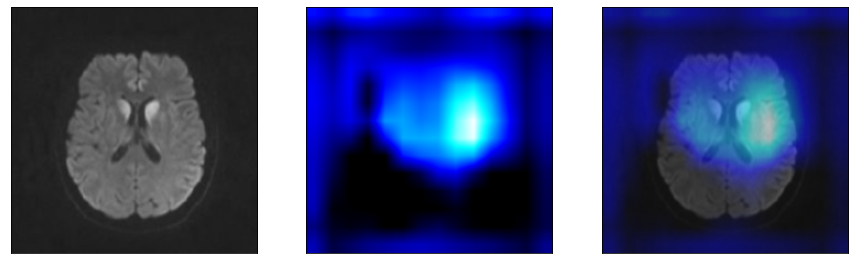

  NO: 76%   YES: 23% 





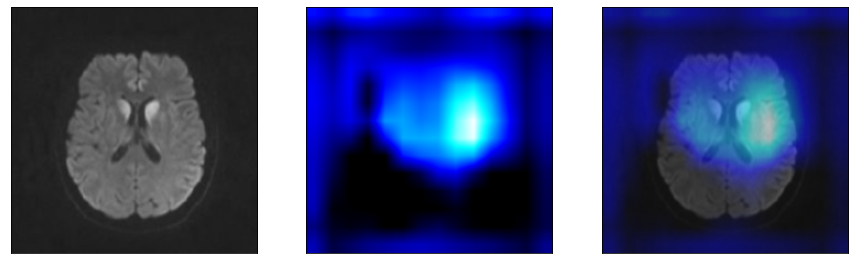

  NO: 76%   YES: 23% 





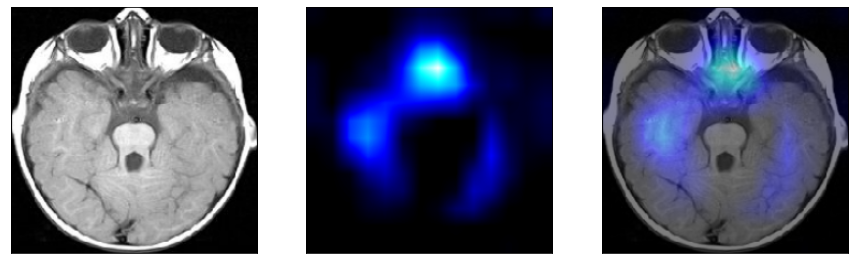

  NO: 81%   YES: 18% 





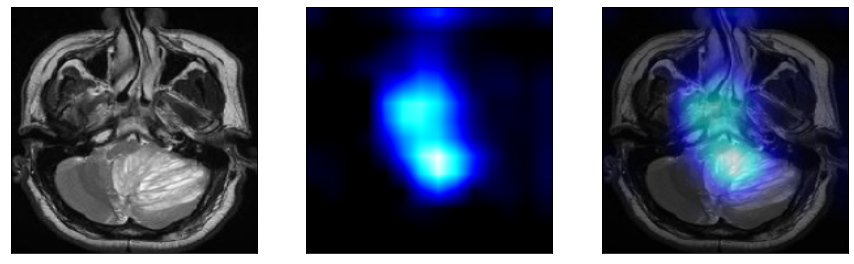

  NO: 84%   YES: 15% 





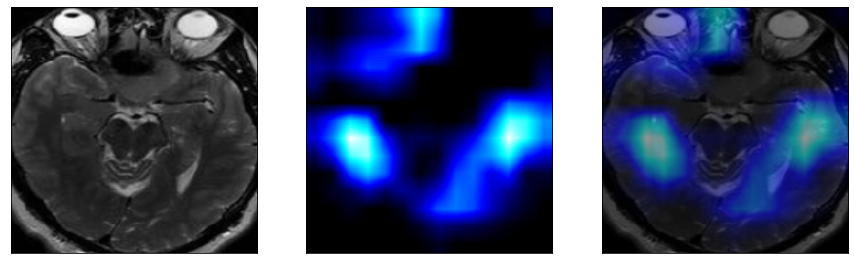

  NO: 84%   YES: 15% 





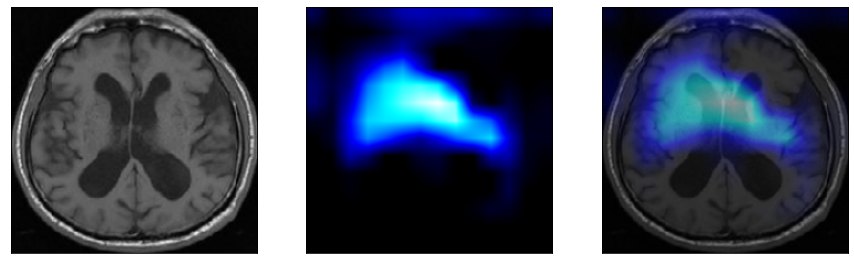

  NO: 87%   YES: 12% 





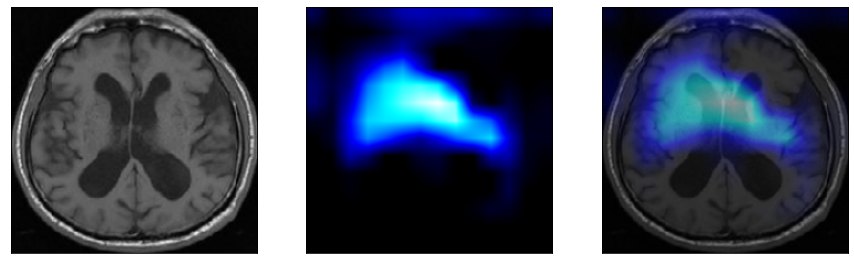

  NO: 87%   YES: 12% 





In [ ]:
inds = np.where(y_te==class_indices['NO'])[0]

inds = sorted(inds, key=lambda i:prob[i][class_indices["NO"]])


for i in inds[:20]:
    show_heatmap(model, X_te[i],num_class)

## Visualise the worst results for the YES class

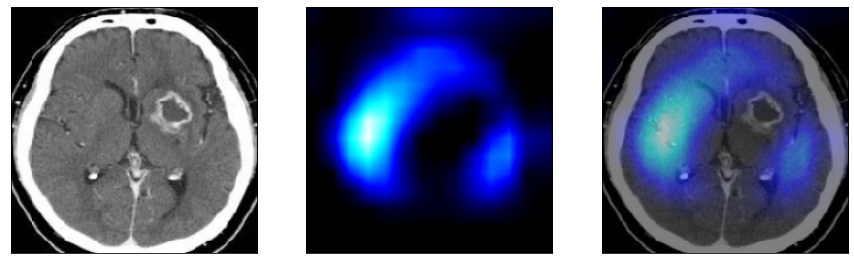

  NO: 99%   YES: 0% 





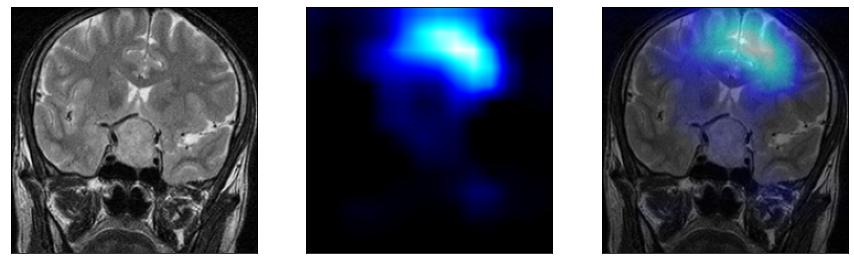

  NO: 99%   YES: 0% 





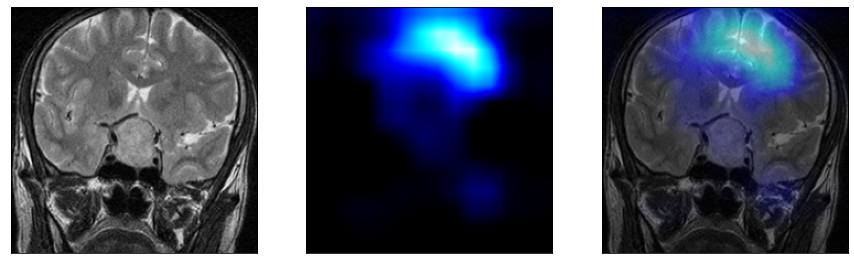

  NO: 99%   YES: 0% 





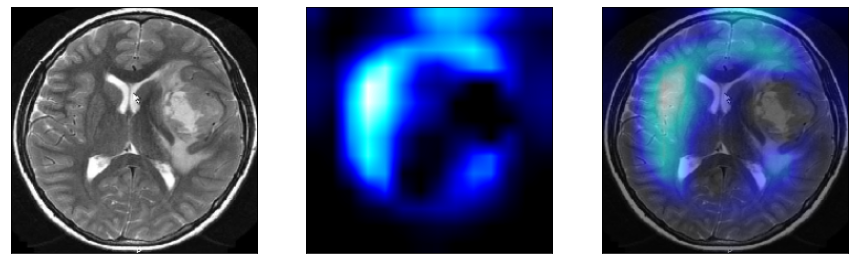

  NO: 99%   YES: 0% 





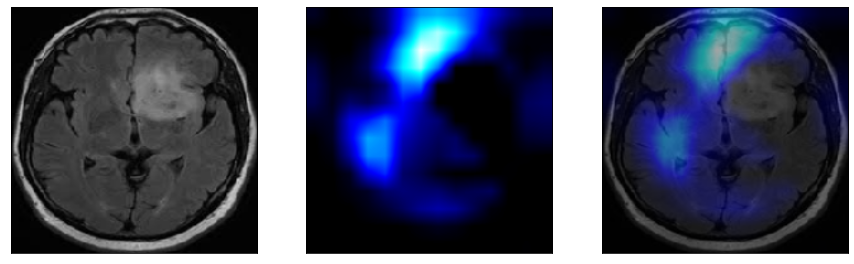

  NO: 87%   YES: 12% 





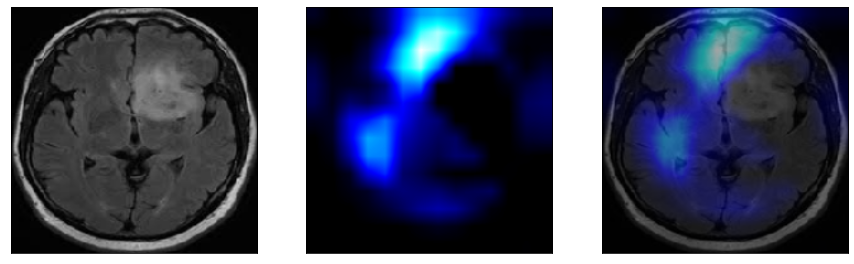

  NO: 87%   YES: 12% 





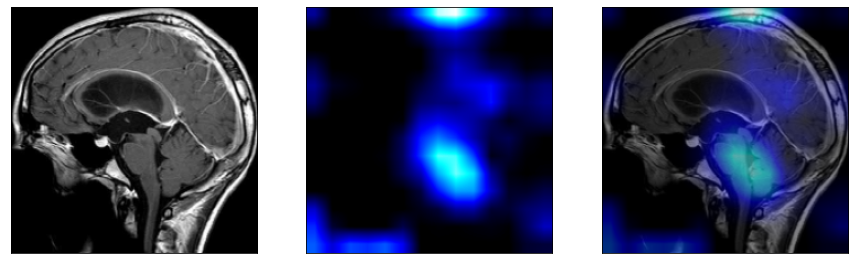

  NO: 64%   YES: 35% 





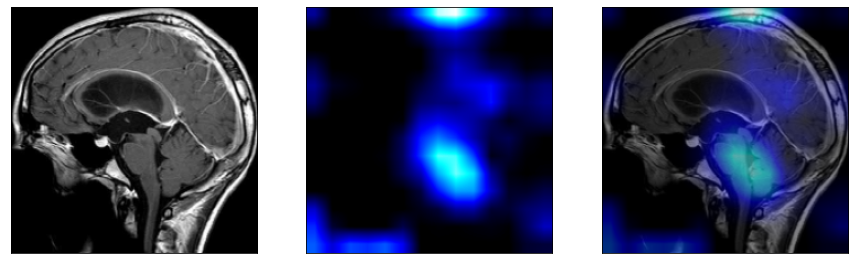

  NO: 64%   YES: 35% 





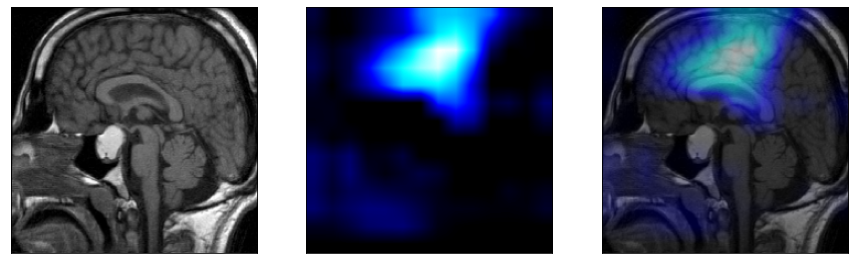

  NO: 63%   YES: 36% 





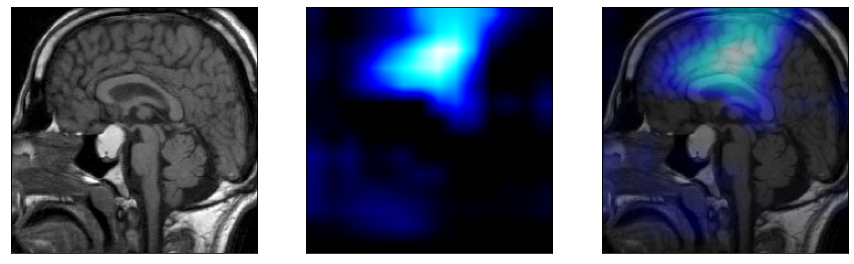

  NO: 58%   YES: 41% 





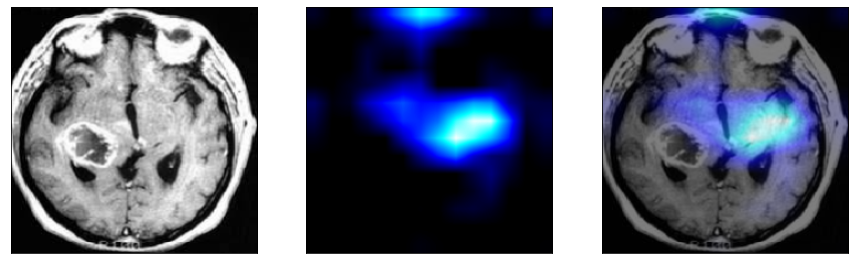

  NO: 54%   YES: 45% 





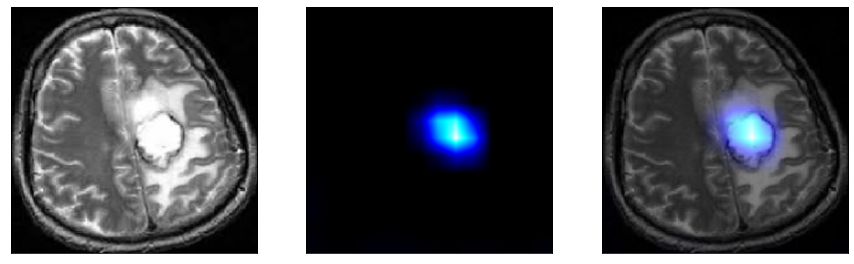

  NO: 38%   YES: 61% 





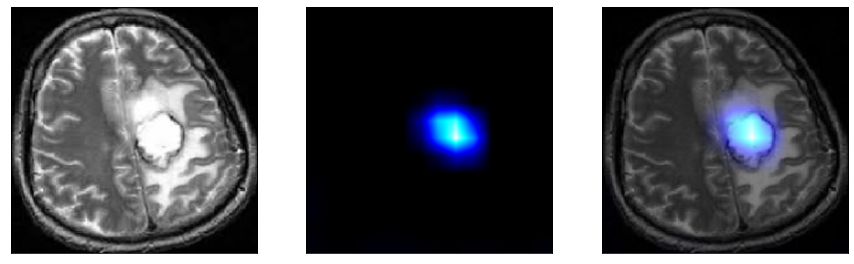

  NO: 38%   YES: 61% 





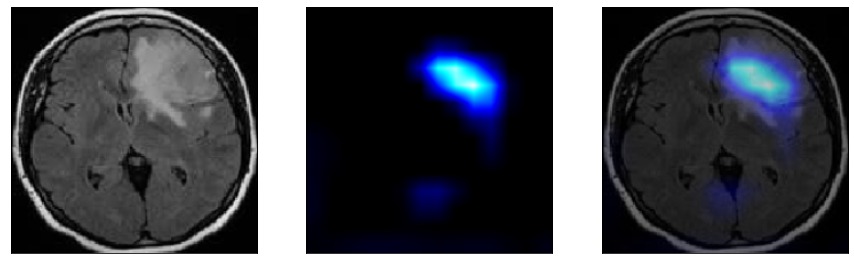

  NO: 36%   YES: 63% 





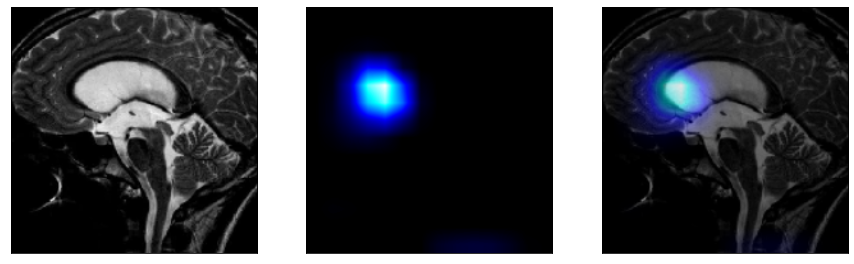

  NO: 27%   YES: 72% 





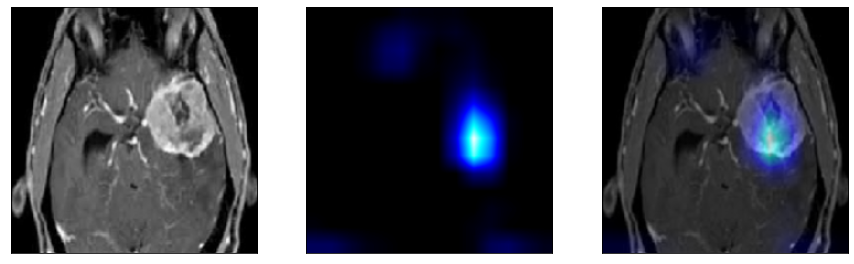

  NO: 19%   YES: 80% 





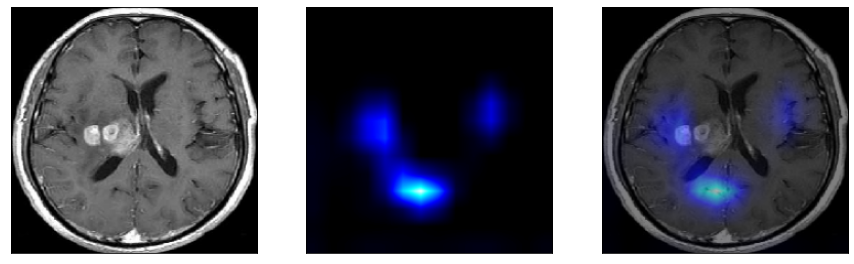

  NO: 15%   YES: 84% 





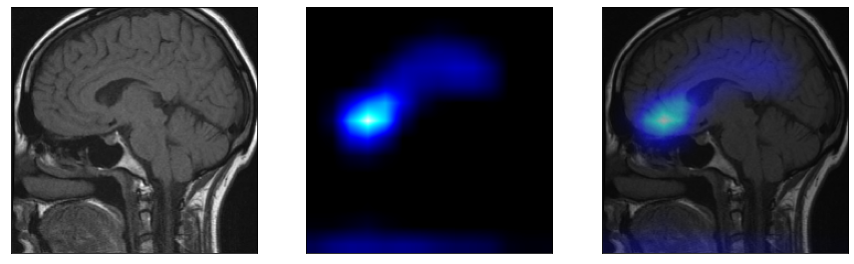

  NO: 8%   YES: 91% 





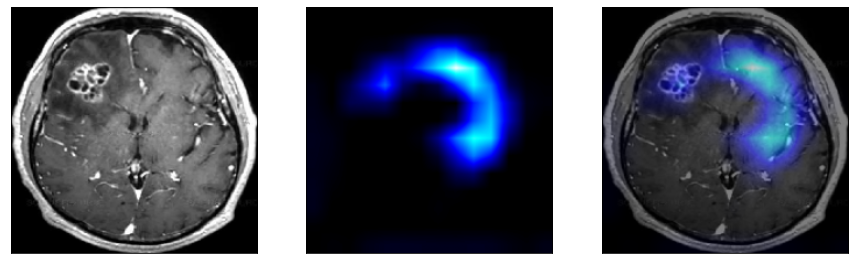

  NO: 8%   YES: 91% 





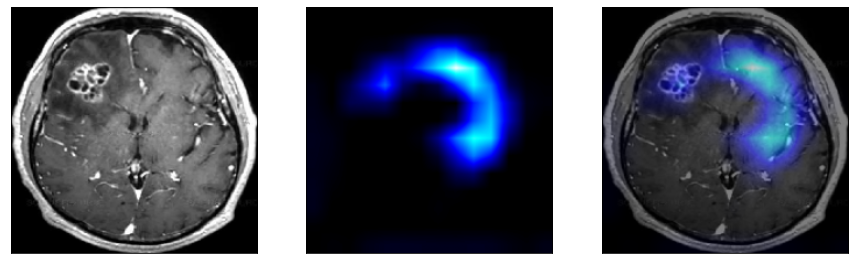

  NO: 8%   YES: 91% 





In [ ]:
inds = np.where(y_te==class_indices['YES'])[0]

inds = sorted(inds, key=lambda i:prob[i][class_indices["YES"]])


for i in inds[:20]:
    show_heatmap(model, X_te[i],num_class)